In [1]:
import os
import shutil

from tensorflow.keras.models import load_model
from tensorflow.keras import layers
from tensorflow.keras import models

import imageio
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [2]:
# Setting up paths
CNN_model = '/kaggle/input/visualizing-what-convbets-learn/models/CNN cats vs dogs model.hdf5'
test_imgs_path = '/kaggle/input/visualizing-what-convbets-learn/test images'

cat_img = '/kaggle/input/visualizing-what-convbets-learn/test images/cat.PNG'
dog_img = '/kaggle/input/visualizing-what-convbets-learn/test images/dog.PNG'

two_cats_img = '/kaggle/input/visualizing-what-convbets-learn/test images/2 cats.PNG'
two_dogs_img = '/kaggle/input/visualizing-what-convbets-learn/test images/2 dogs.PNG'

cat_activations = '/kaggle/working/activations/cat'
dog_activations = '/kaggle/working/activations/dog'

two_cats_activations = '/kaggle/working/activations/two_cats'
two_dogs_activations = '/kaggle/working/activations/two_dogs'



In [3]:
model = load_model(CNN_model)
model.summary()

2023-02-21 00:50:01.490483: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib/python3.7/site-packages/cv2/../../lib64:/usr/local/cuda/lib64:/usr/local/cuda/lib:/usr/local/lib/x86_64-linux-gnu:/usr/local/nvidia/lib:/usr/local/nvidia/lib64::/opt/conda/lib
2023-02-21 00:50:01.490569: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 batch_normalization_4 (Batc  (None, 126, 126, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 63, 63, 32)        0         
                                                                 
 conv2d_4 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 batch_normalization_5 (Batc  (None, 61, 61, 64)      

2 cats.PNG
<class 'numpy.ndarray'>
4.8152042e-09
2 dogs.PNG
<class 'numpy.ndarray'>
0.99938726
dog.PNG
<class 'numpy.ndarray'>
0.99410754
cat.PNG
<class 'numpy.ndarray'>
9.113619e-05


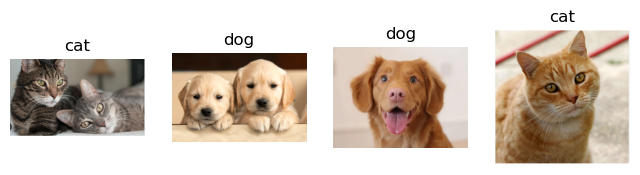

In [4]:
# testing and visualizing CNN model predictions
labels = ["cat","dog"]

ncols = len(os.listdir(test_imgs_path))
fig = plt.figure(figsize=(8, 5))
for i , img_file in enumerate(os.listdir(test_imgs_path)):
    print(img_file)
    img = cv2.imread(os.path.join(test_imgs_path,img_file))
    if (img is None):
        continue
    print(type(img))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    fig.add_subplot(1, ncols, i+1)
    plt.imshow(img)
    plt.axis('off')
    
    img = cv2.resize(img,(128,128))
    img = img / 255
    img = np.reshape(img,(1,128,128,3))
    
    results = model.predict(img,verbose = 0)
    results = np.squeeze(results)
    plt.title(labels[np.round(results).astype(int)])

    print(results)
    

In [5]:
# Get the index of the flatten layer 
for i, layer in enumerate(model.layers):
    print(i,layer.name)
    if layer.name.startswith("flatten"):
        break
print(i)

0 conv2d_3
1 batch_normalization_4
2 max_pooling2d_3
3 dropout_4
4 conv2d_4
5 batch_normalization_5
6 max_pooling2d_4
7 dropout_5
8 conv2d_5
9 batch_normalization_6
10 max_pooling2d_5
11 dropout_6
12 conv2d_6
13 batch_normalization_7
14 max_pooling2d_6
15 dropout_7
16 flatten_1
16


In [6]:
# the outputs of the activation model are the outputs of each layer of
# the CNN model up until the flatten layer
layers_outputs = [layer.output for layer in model.layers[:i]]

In [7]:
# building the activations model
activations_model = models.Model(inputs = model.input, outputs = layers_outputs)
activations_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3_input (InputLayer)  [(None, 128, 128, 3)]    0         
                                                                 
 conv2d_3 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 batch_normalization_4 (Batc  (None, 126, 126, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 63, 63, 32)        0         
                                                                 
 conv2d_4 (Conv2D)           (None, 61, 61, 64)        18496 

In [8]:
def get_model_activations(img_path,model,verbose = False):
    
    #preprocess img
    img = cv2.imread(img_path)
    print(type(img))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img = cv2.resize(img,(128,128))
    img = img / 255
    img = np.reshape(img,(1,128,128,3))

    # feed forward the preprocessed image to the activations model
    activations = model.predict(img)
    if verbose:
        print(len(activations))
        for i , activation in enumerate(activations) :
            print(f' layer n°{i} shape : {activation.shape}')
    
    return activations

In [9]:
activations = get_model_activations(cat_img,activations_model)

<class 'numpy.ndarray'>
1/1 [==============================] - 0s 142ms/step


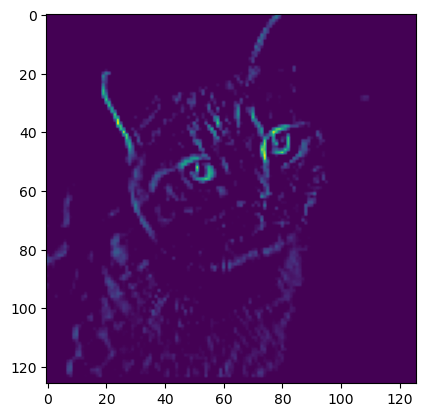

In [10]:
plt.imshow(activations[0][0,:,:,4], cmap = 'viridis')

In [11]:
def display_activations(img_pth ,activations_model , 
                        images_per_row = 16 , save_dir =None
                       ):
    
    activations = get_model_activations(img_pth
                                        ,activations_model)
    # Get the index of the flatten layer 
    for i, layer in enumerate(model.layers):
        print(i,layer.name)
        
        if layer.name.startswith("flatten"):
            break
    print(i)
    grids = []
    layer_names = []
    for idx,layer in enumerate(activations_model.layers[1:i+1]):
        layer_names.append(f'{(idx +1):02d} {layer.name}')
    print("********************************************************")
    print(layer_names)
    #images_per_row = 16
    for layer_name, layer_activation in zip(layer_names, activations):
        n_features = layer_activation.shape[-1]
        size = layer_activation.shape[1]
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,
                :, :,
                col * images_per_row + row]
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,
                row * size : (row + 1) * size] = channel_image
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))

        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        print(display_grid.shape)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')
        #grids.append((layer_name, display_grid))
        if save_dir is not None:
            if not os.path.isdir(save_dir):
                print(f"Creating {save_dir} ... ")
                os.makedirs(save_dir)
            
            plt.savefig(f'{save_dir}/{layer_name}.png')
            #print(f'{save_dir}/{layer_name}.png')


<class 'numpy.ndarray'>
1/1 [==============================] - 0s 34ms/step
16
 layer n°0 shape : (1, 126, 126, 32)
 layer n°1 shape : (1, 126, 126, 32)
 layer n°2 shape : (1, 63, 63, 32)
 layer n°3 shape : (1, 63, 63, 32)
 layer n°4 shape : (1, 61, 61, 64)
 layer n°5 shape : (1, 61, 61, 64)
 layer n°6 shape : (1, 30, 30, 64)
 layer n°7 shape : (1, 30, 30, 64)
 layer n°8 shape : (1, 28, 28, 128)
 layer n°9 shape : (1, 28, 28, 128)
 layer n°10 shape : (1, 14, 14, 128)
 layer n°11 shape : (1, 14, 14, 128)
 layer n°12 shape : (1, 12, 12, 256)
 layer n°13 shape : (1, 12, 12, 256)
 layer n°14 shape : (1, 6, 6, 256)
 layer n°15 shape : (1, 6, 6, 256)
0 conv2d_3
1 batch_normalization_4
2 max_pooling2d_3
3 dropout_4
4 conv2d_4
5 batch_normalization_5
6 max_pooling2d_4
7 dropout_5
8 conv2d_5
9 batch_normalization_6
10 max_pooling2d_5
11 dropout_6
12 conv2d_6
13 batch_normalization_7
14 max_pooling2d_6
15 dropout_7
16 flatten_1
16
********************************************************
['01 con

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: divide by zero encountered in true_divide


(252, 2016)
(126, 1008)
(126, 1008)
(244, 976)
(244, 976)
(120, 480)
(120, 480)
(224, 448)
(224, 448)
(112, 224)
(112, 224)
(192, 192)
(192, 192)
(96, 96)
(96, 96)


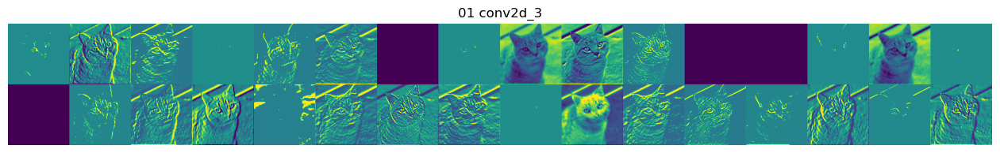

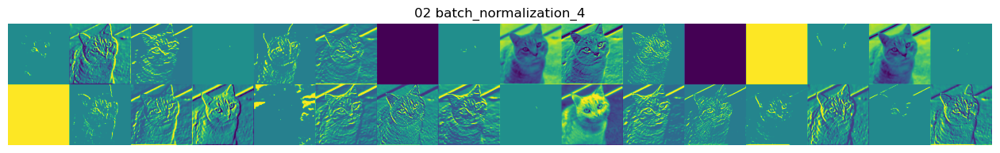

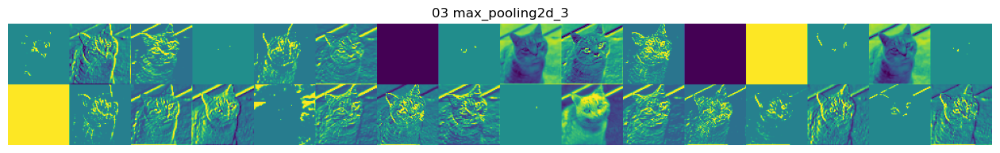

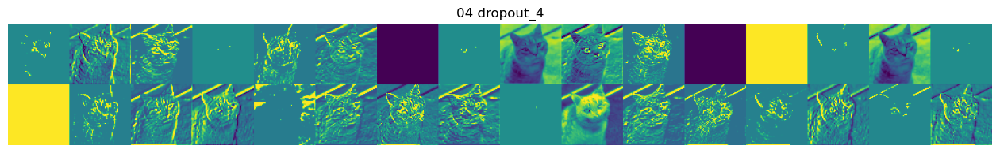

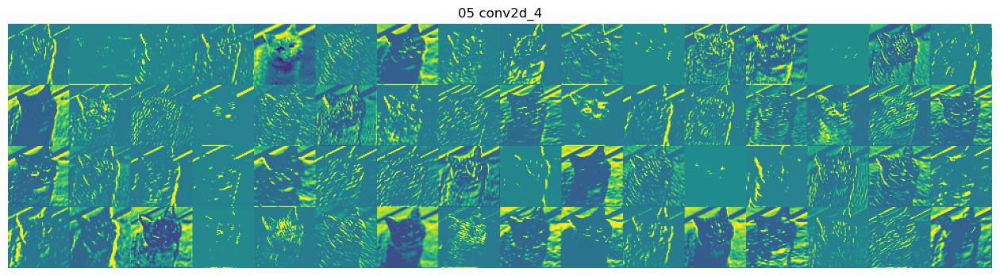

...

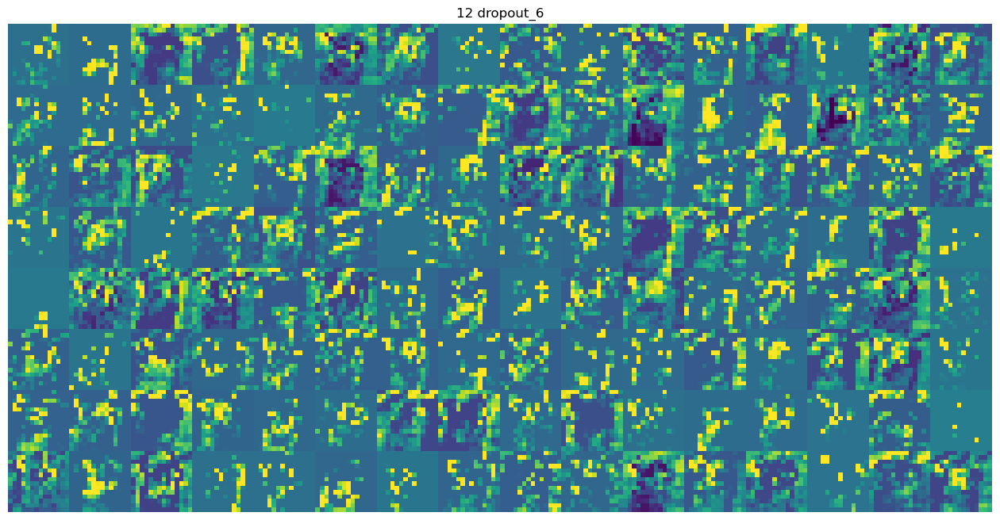

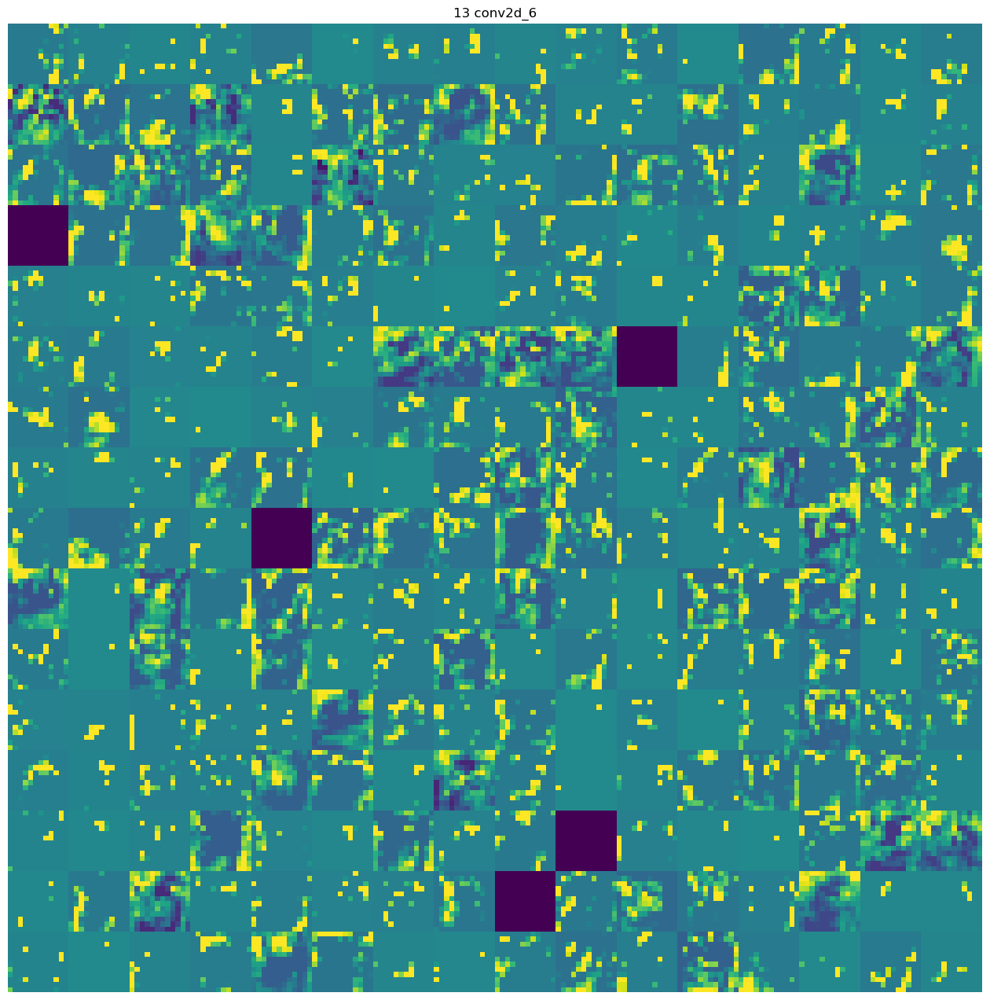

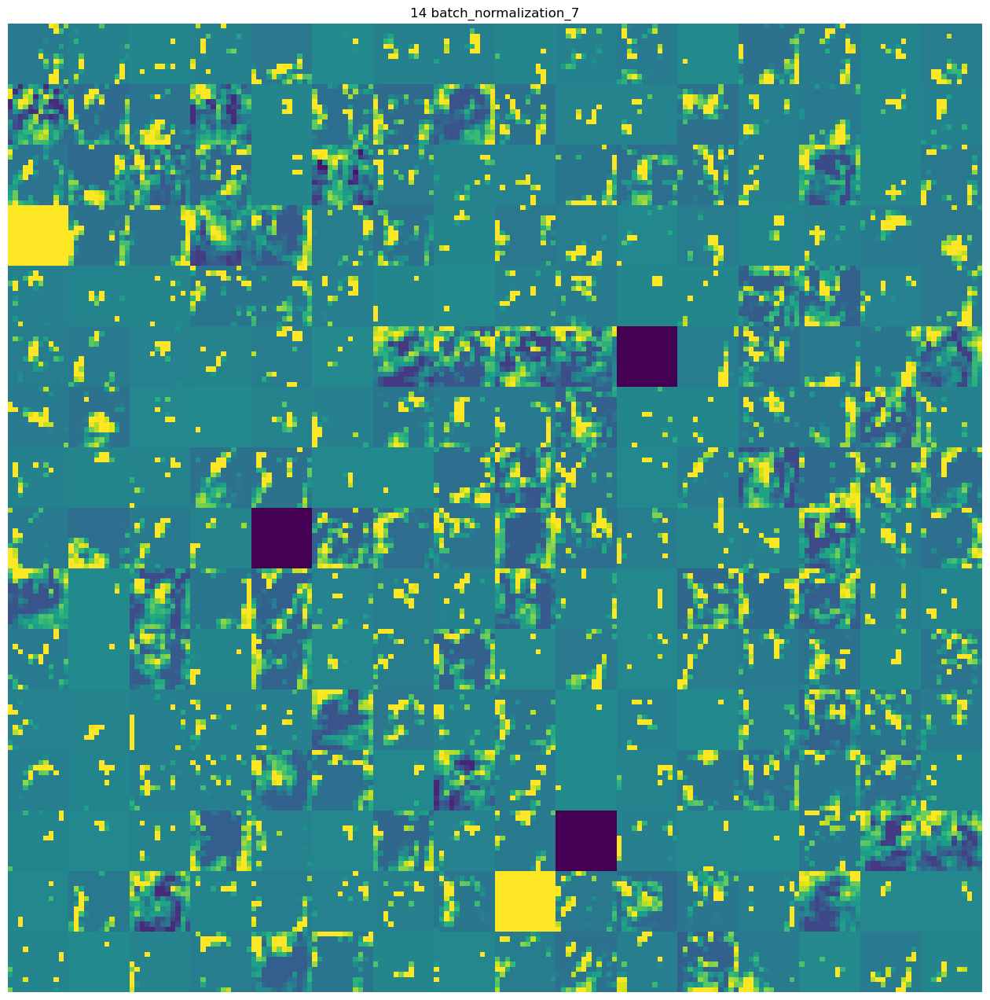

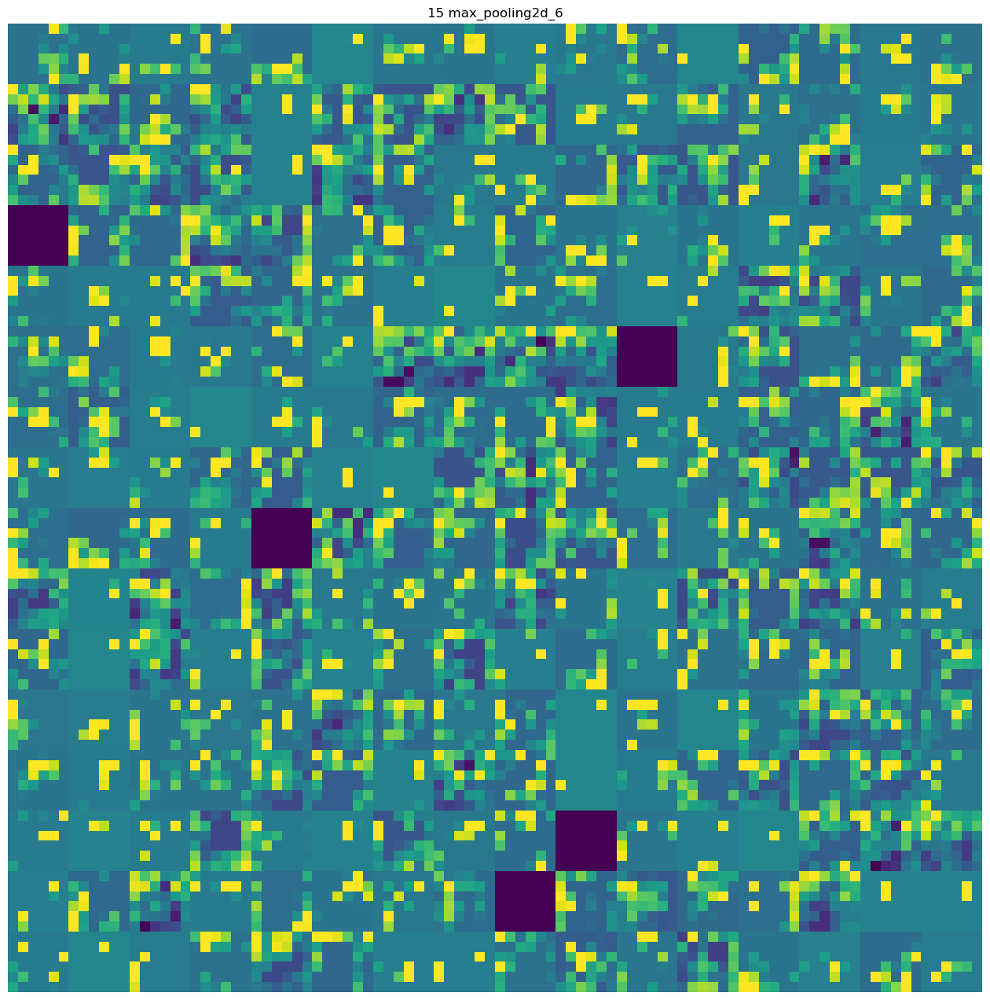

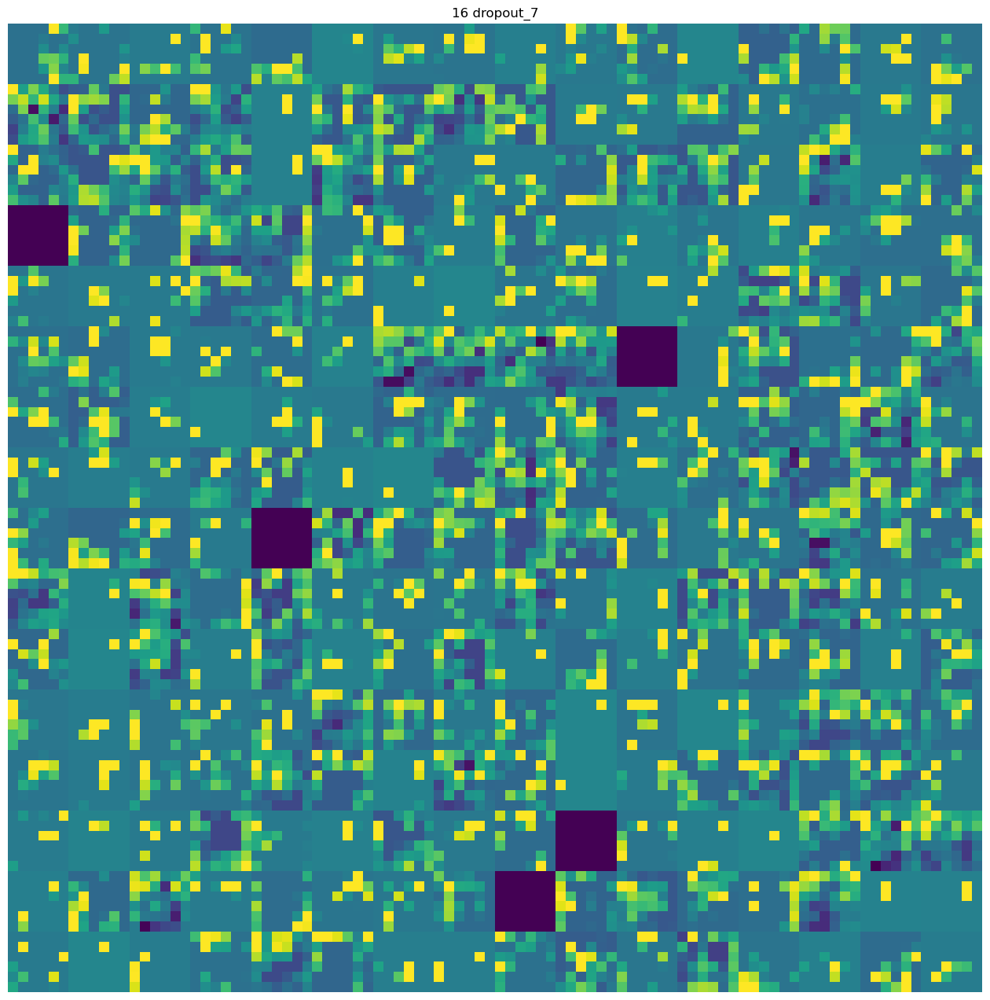

In [12]:
display_activations(img_pth = cat_img ,activations_model = activations_model
                    , images_per_row = 16 , save_dir = cat_activations)

In [13]:
def center_imgs(imgs_dir):
    for i,filename in enumerate(os.listdir(imgs_dir)):
        img = 255 * np.ones((1600,1600,3))
        fig = cv2.imread(os.path.join(imgs_dir,filename))
        img[(img.shape[0] // 2 ) - fig.shape[0] // 2:  (img.shape[0] // 2 ) + fig.shape[0] // 2] = fig
        
        text = f'{filename[:-4]}'
        font = cv2.FONT_HERSHEY_SIMPLEX
        text_scale = 2.75
        text_thickness = 8
        text_size = cv2.getTextSize(text, font, text_scale, text_thickness)[0]
        height, width, _ = img.shape
        
        x = int((width - text_size[0]) / 2)
        y = int((height + text_size[1]) / 2)
        
        img = cv2.putText(img,text,(x,150),font, text_scale, (0, 0, 255), text_thickness, cv2.LINE_AA)
        cv2.imwrite(f"{imgs_dir}/{filename}", img)
        print(filename , img.shape)
    


15 max_pooling2d_6.png (1600, 1600, 3)
05 conv2d_4.png (1600, 1600, 3)
03 max_pooling2d_3.png (1600, 1600, 3)
16 dropout_7.png (1600, 1600, 3)
06 batch_normalization_5.png (1600, 1600, 3)
09 conv2d_5.png (1600, 1600, 3)
02 batch_normalization_4.png (1600, 1600, 3)
07 max_pooling2d_4.png (1600, 1600, 3)
01 conv2d_3.png (1600, 1600, 3)
04 dropout_4.png (1600, 1600, 3)
10 batch_normalization_6.png (1600, 1600, 3)
08 dropout_5.png (1600, 1600, 3)
11 max_pooling2d_5.png (1600, 1600, 3)
12 dropout_6.png (1600, 1600, 3)
14 batch_normalization_7.png (1600, 1600, 3)
13 conv2d_6.png (1600, 1600, 3)



/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  This is separate from the ipykernel package so we can avoid doing imports until


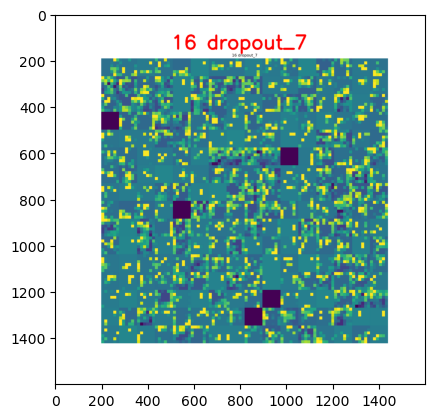

In [14]:
center_imgs(cat_activations)
print()
plt.imshow(imageio.imread(os.path.join(cat_activations,os.listdir(cat_activations)[3])))

In [15]:
print(len(os.listdir('/kaggle/working/activations')))
print(os.listdir(cat_activations))


1
['15 max_pooling2d_6.png', '05 conv2d_4.png', '03 max_pooling2d_3.png', '16 dropout_7.png', '06 batch_normalization_5.png', '09 conv2d_5.png', '02 batch_normalization_4.png', '07 max_pooling2d_4.png', '01 conv2d_3.png', '04 dropout_4.png', '10 batch_normalization_6.png', '08 dropout_5.png', '11 max_pooling2d_5.png', '12 dropout_6.png', '14 batch_normalization_7.png', '13 conv2d_6.png']


In [11]:
def create_gif(source_path,save_dir,fps = 0.5):
    with imageio.get_writer(save_dir, mode='I', fps = fps) as writer:
        for filename in sorted(os.listdir(source_path)):
            print(filename)
            image = imageio.imread(os.path.join(source_path,filename))
            writer.append_data(image)

In [17]:
create_gif(cat_activations,'cat activations.gif',fps = 0.5)

01 conv2d_3.png


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


02 batch_normalization_4.png
03 max_pooling2d_3.png
04 dropout_4.png
05 conv2d_4.png
06 batch_normalization_5.png
07 max_pooling2d_4.png
08 dropout_5.png
09 conv2d_5.png
10 batch_normalization_6.png
11 max_pooling2d_5.png
12 dropout_6.png
13 conv2d_6.png
14 batch_normalization_7.png
15 max_pooling2d_6.png
16 dropout_7.png


<class 'numpy.ndarray'>
1/1 [==============================] - 0s 34ms/step
16
 layer n°0 shape : (1, 126, 126, 32)
 layer n°1 shape : (1, 126, 126, 32)
 layer n°2 shape : (1, 63, 63, 32)
 layer n°3 shape : (1, 63, 63, 32)
 layer n°4 shape : (1, 61, 61, 64)
 layer n°5 shape : (1, 61, 61, 64)
 layer n°6 shape : (1, 30, 30, 64)
 layer n°7 shape : (1, 30, 30, 64)
 layer n°8 shape : (1, 28, 28, 128)
 layer n°9 shape : (1, 28, 28, 128)
 layer n°10 shape : (1, 14, 14, 128)
 layer n°11 shape : (1, 14, 14, 128)
 layer n°12 shape : (1, 12, 12, 256)
 layer n°13 shape : (1, 12, 12, 256)
 layer n°14 shape : (1, 6, 6, 256)
 layer n°15 shape : (1, 6, 6, 256)
0 conv2d_3
1 batch_normalization_4
2 max_pooling2d_3
3 dropout_4
4 conv2d_4
5 batch_normalization_5
6 max_pooling2d_4
7 dropout_5
8 conv2d_5
9 batch_normalization_6
10 max_pooling2d_5
11 dropout_6
12 conv2d_6
13 batch_normalization_7
14 max_pooling2d_6
15 dropout_7
16 flatten_1
16
********************************************************
['01 con

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: divide by zero encountered in true_divide


(252, 2016)
(126, 1008)
(126, 1008)
(244, 976)
(244, 976)
(120, 480)
(120, 480)
(224, 448)
(224, 448)
(112, 224)
(112, 224)
(192, 192)
(192, 192)
(96, 96)
(96, 96)


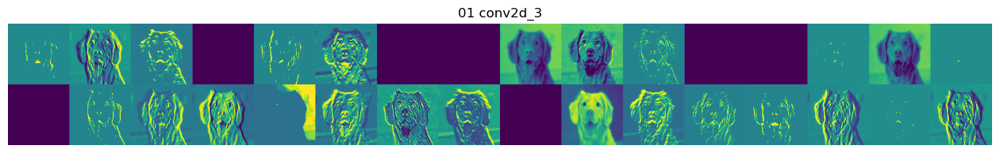

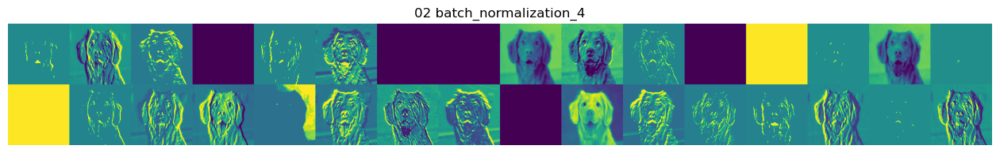

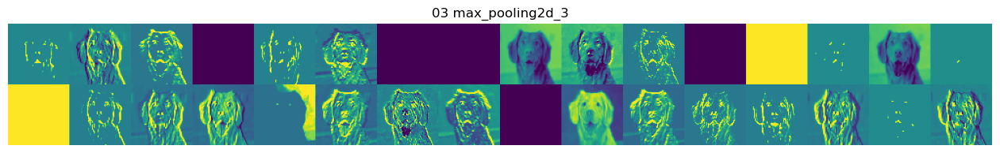

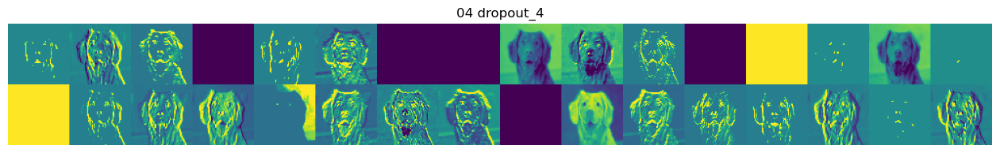

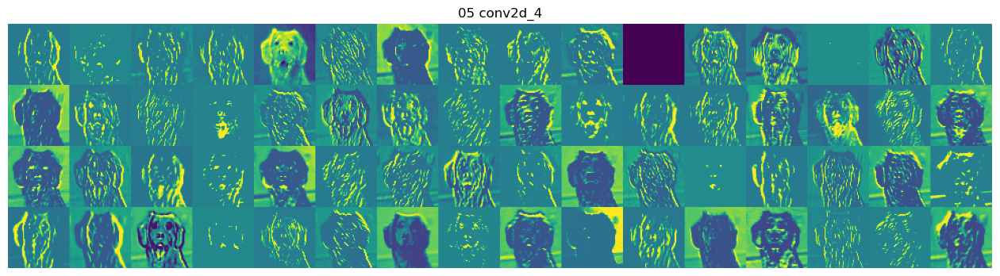

...

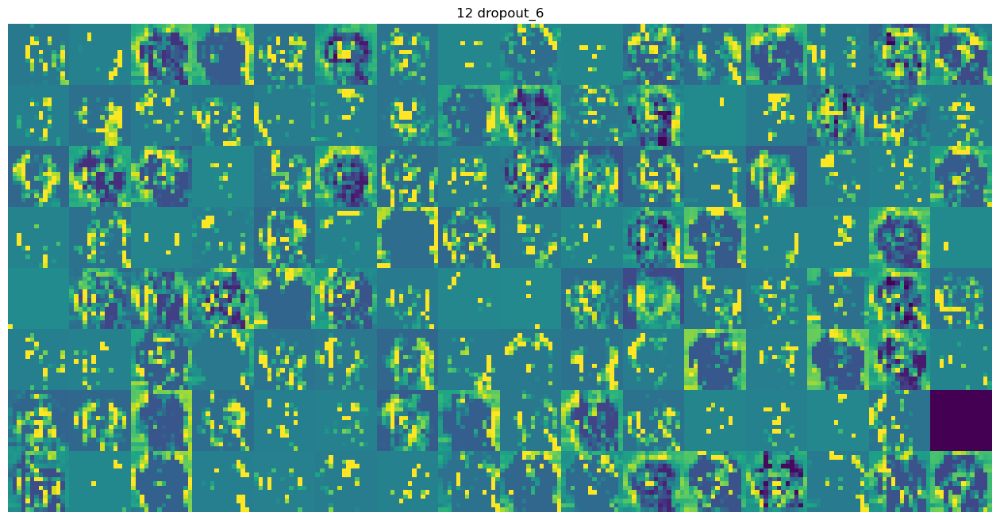

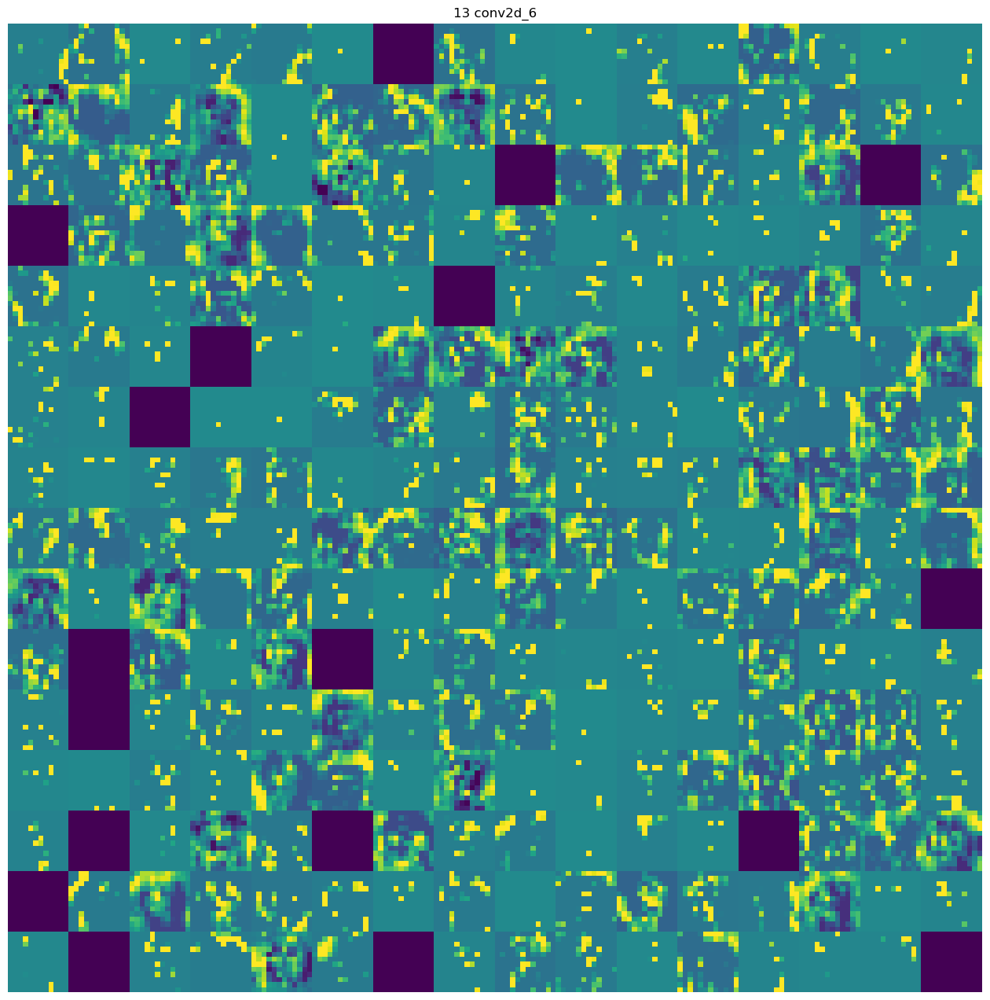

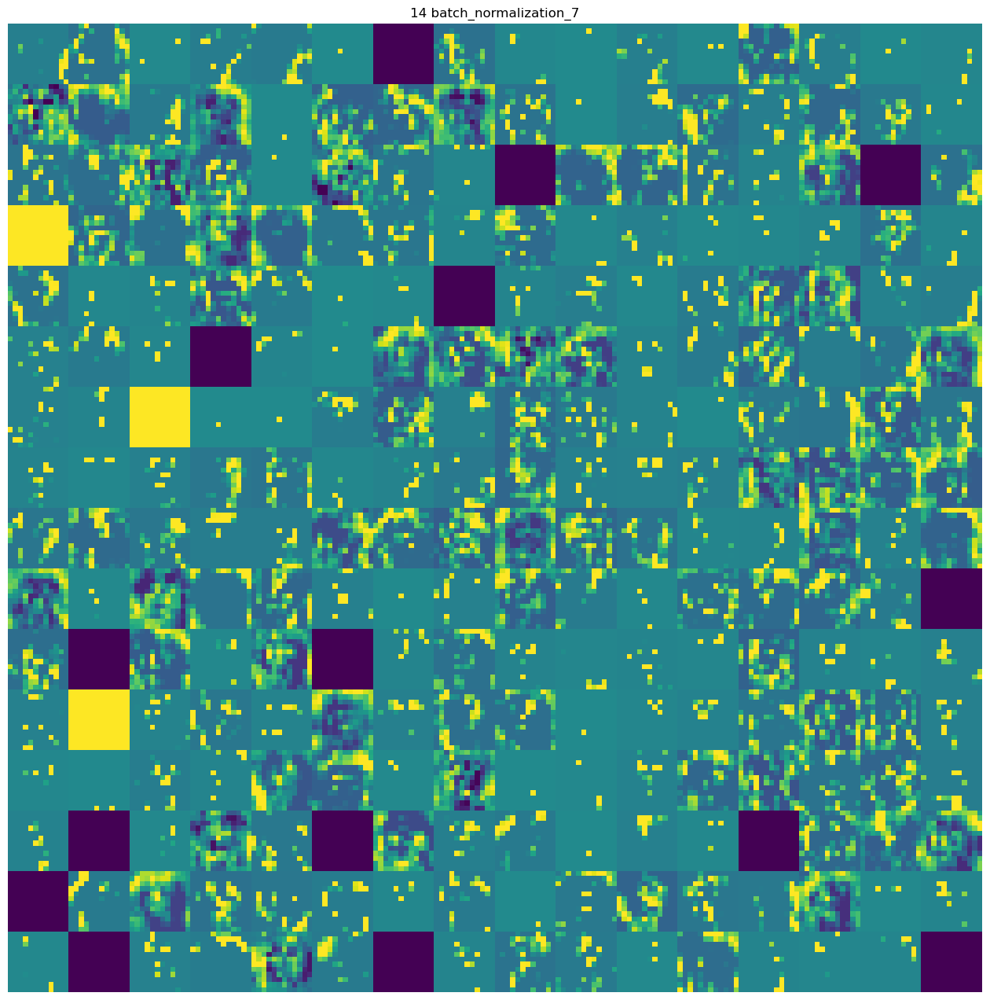

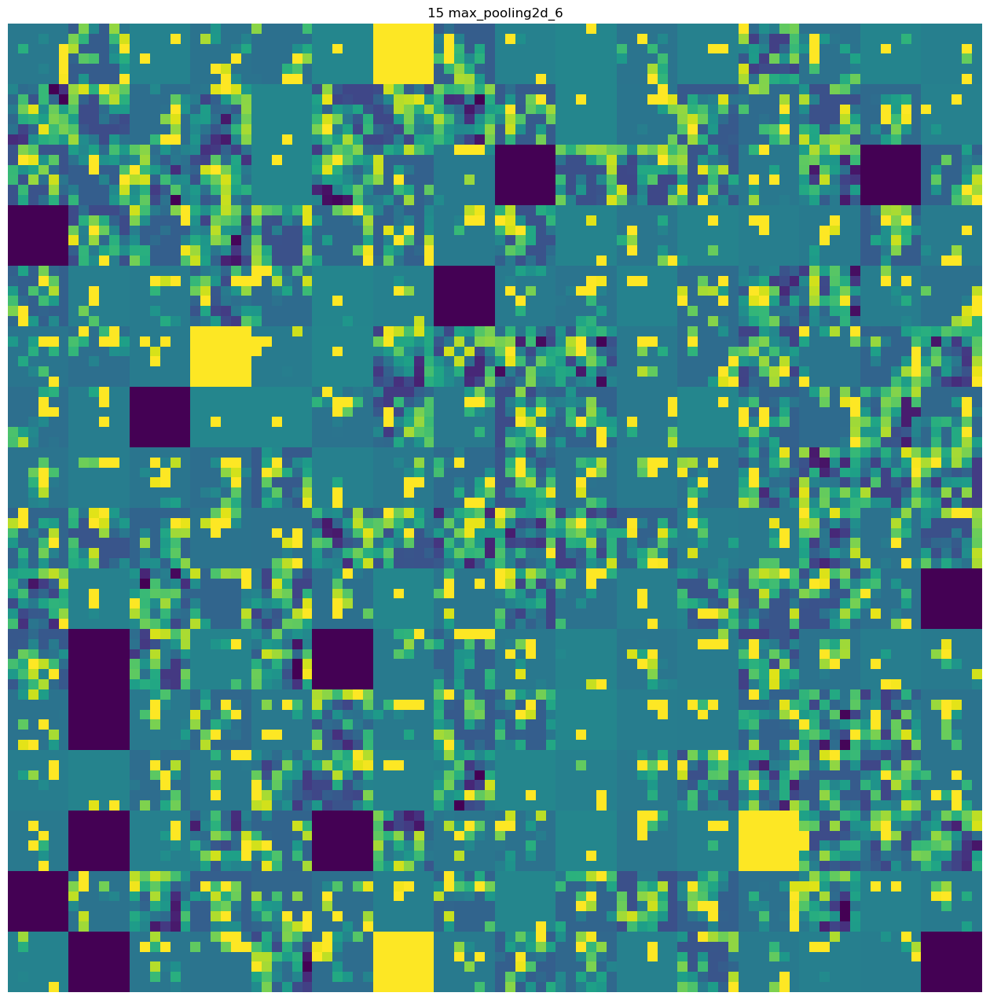

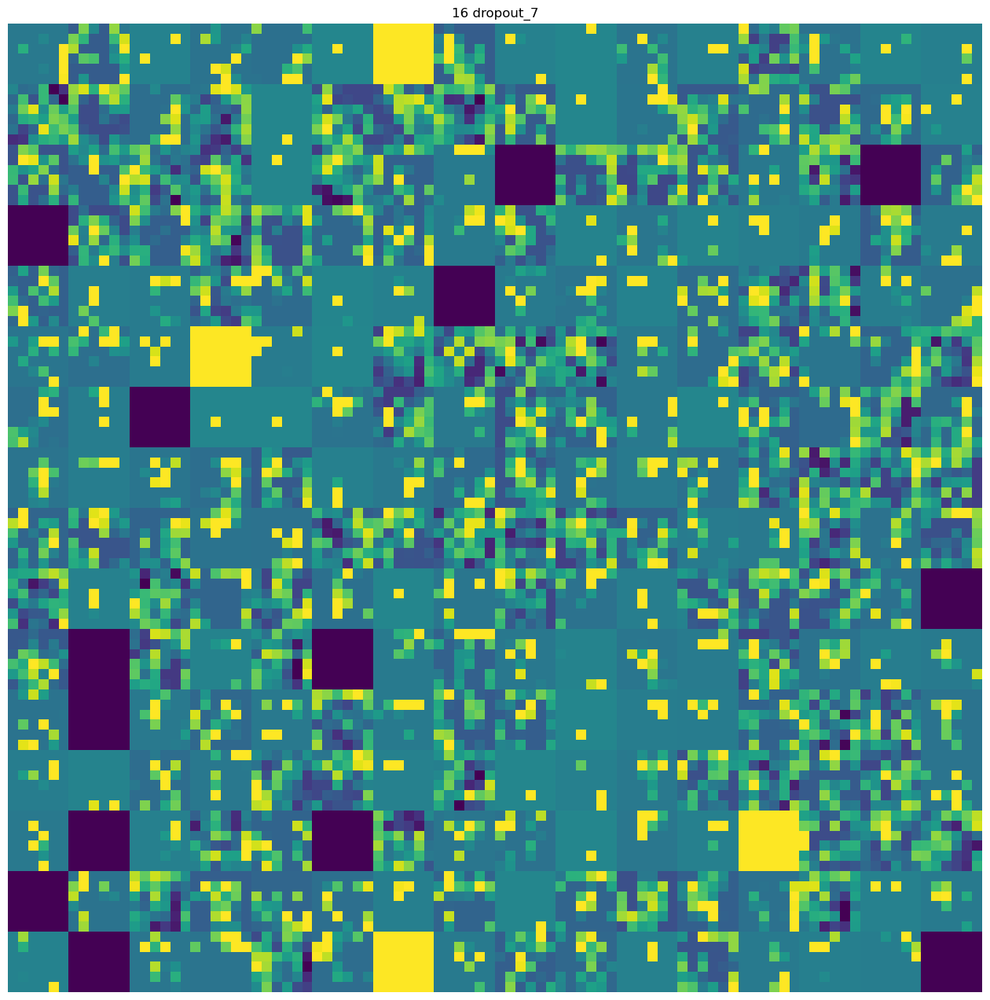

In [18]:
display_activations(img_pth = dog_img ,activations_model = activations_model
                    , images_per_row = 16 , save_dir = dog_activations)





<class 'numpy.ndarray'>
1/1 [==============================] - 0s 30ms/step
16
 layer n°0 shape : (1, 126, 126, 32)
 layer n°1 shape : (1, 126, 126, 32)
 layer n°2 shape : (1, 63, 63, 32)
 layer n°3 shape : (1, 63, 63, 32)
 layer n°4 shape : (1, 61, 61, 64)
 layer n°5 shape : (1, 61, 61, 64)
 layer n°6 shape : (1, 30, 30, 64)
 layer n°7 shape : (1, 30, 30, 64)
 layer n°8 shape : (1, 28, 28, 128)
 layer n°9 shape : (1, 28, 28, 128)
 layer n°10 shape : (1, 14, 14, 128)
 layer n°11 shape : (1, 14, 14, 128)
 layer n°12 shape : (1, 12, 12, 256)
 layer n°13 shape : (1, 12, 12, 256)
 layer n°14 shape : (1, 6, 6, 256)
 layer n°15 shape : (1, 6, 6, 256)
0 conv2d_3
1 batch_normalization_4
2 max_pooling2d_3
3 dropout_4
4 conv2d_4
5 batch_normalization_5
6 max_pooling2d_4
7 dropout_5
8 conv2d_5
9 batch_normalization_6
10 max_pooling2d_5
11 dropout_6
12 conv2d_6
13 batch_normalization_7
14 max_pooling2d_6
15 dropout_7
16 flatten_1
16
********************************************************
['01 con

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: divide by zero encountered in true_divide


(252, 2016)
(126, 1008)
(126, 1008)
(244, 976)
(244, 976)
(120, 480)
(120, 480)
(224, 448)
(224, 448)
(112, 224)
(112, 224)
(192, 192)
(192, 192)
(96, 96)
(96, 96)


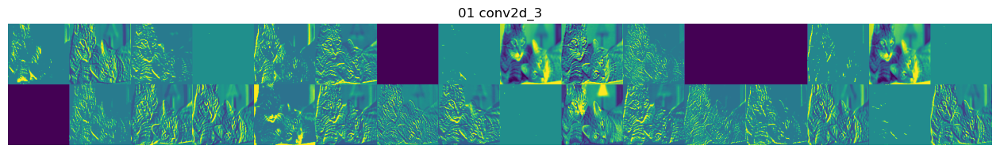

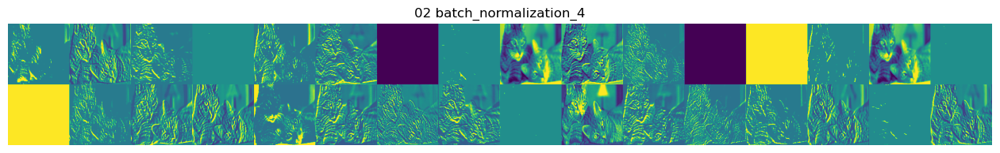

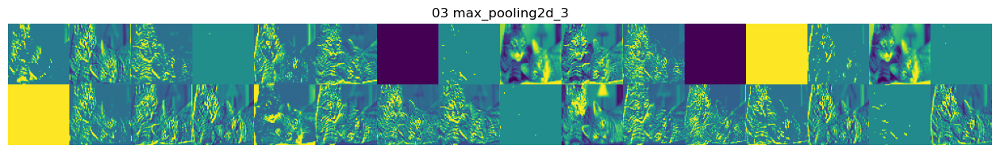

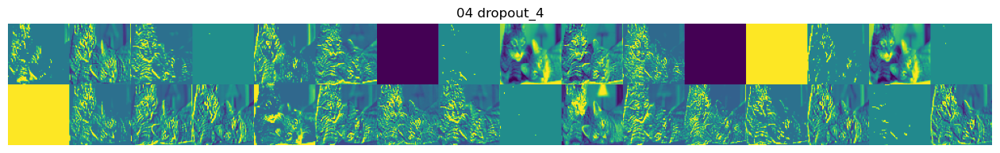

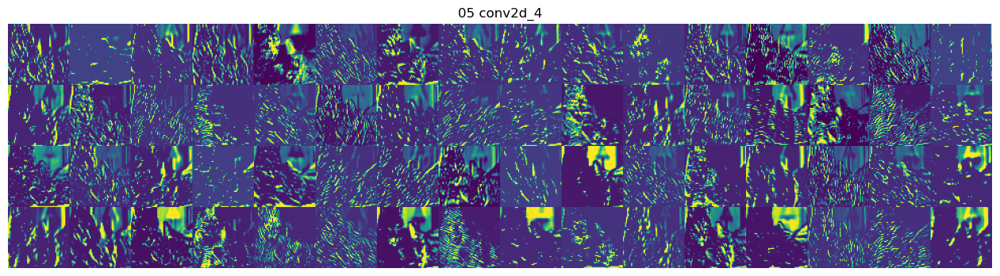

...

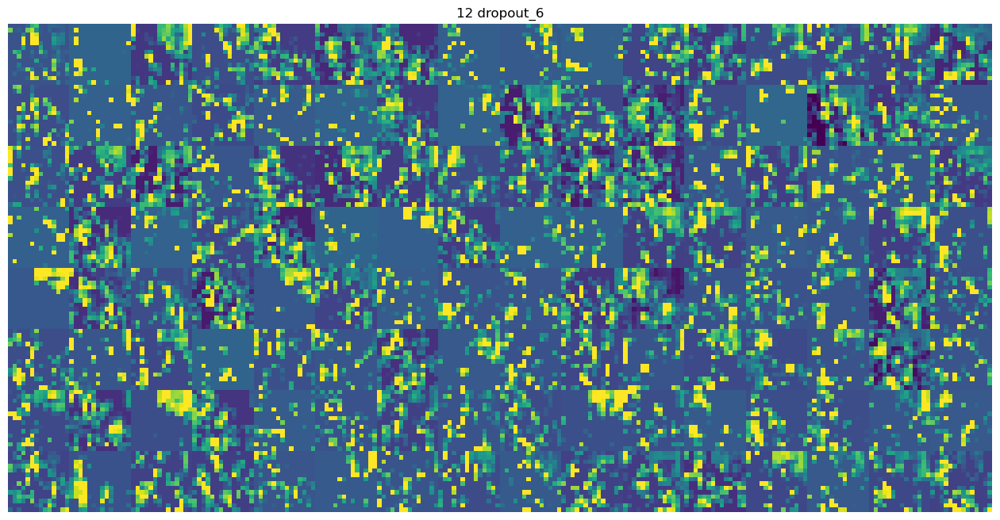

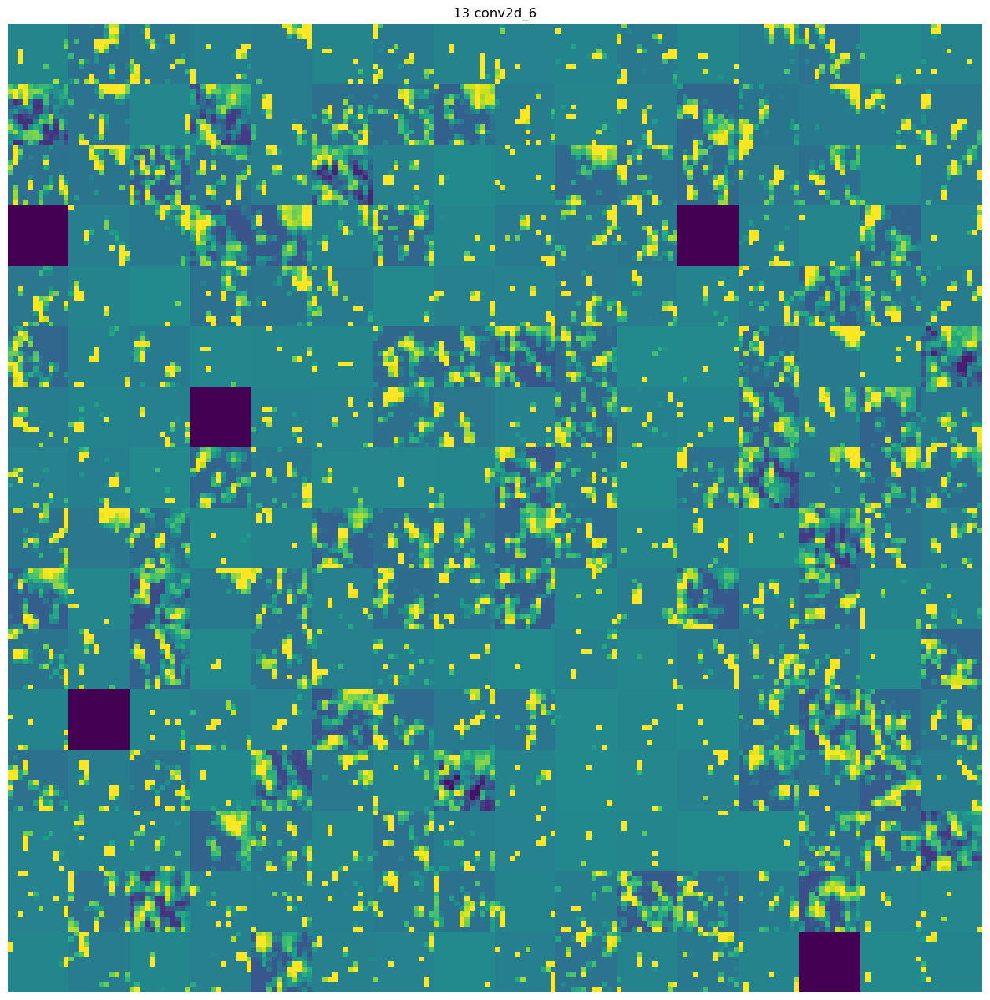

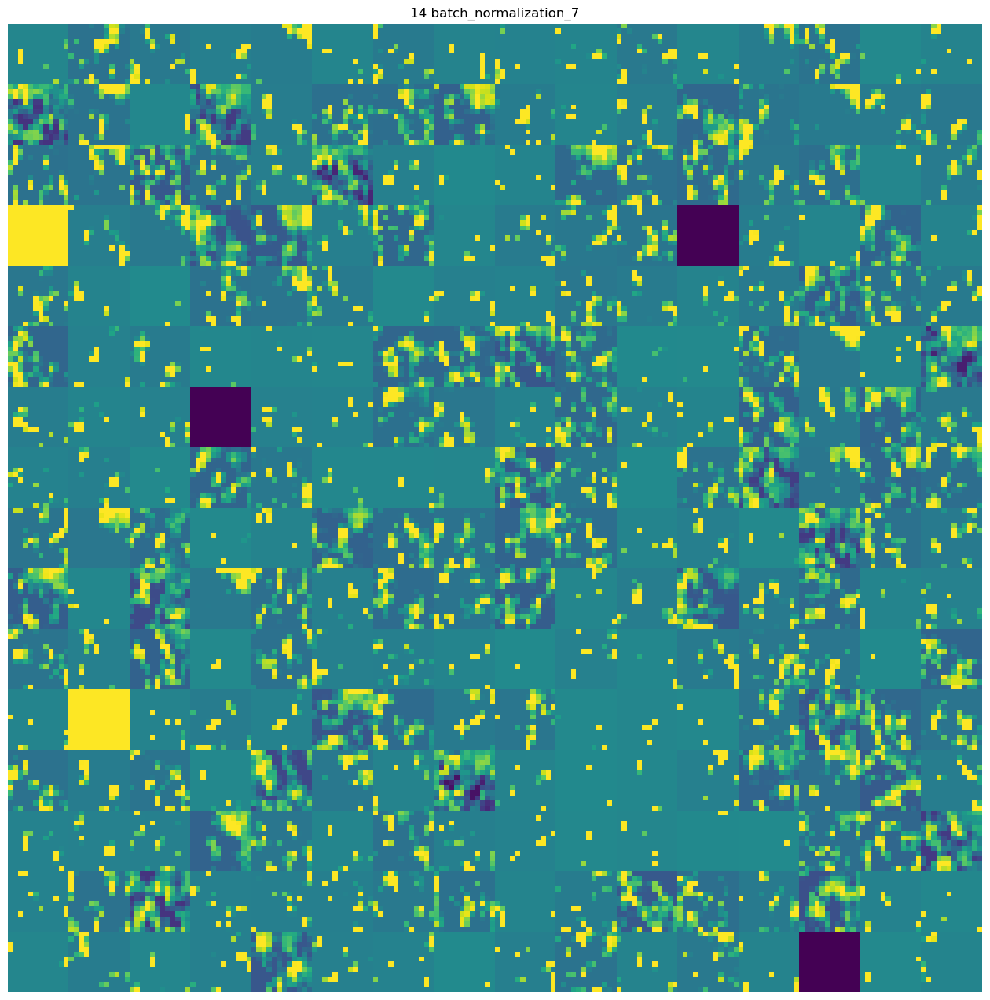

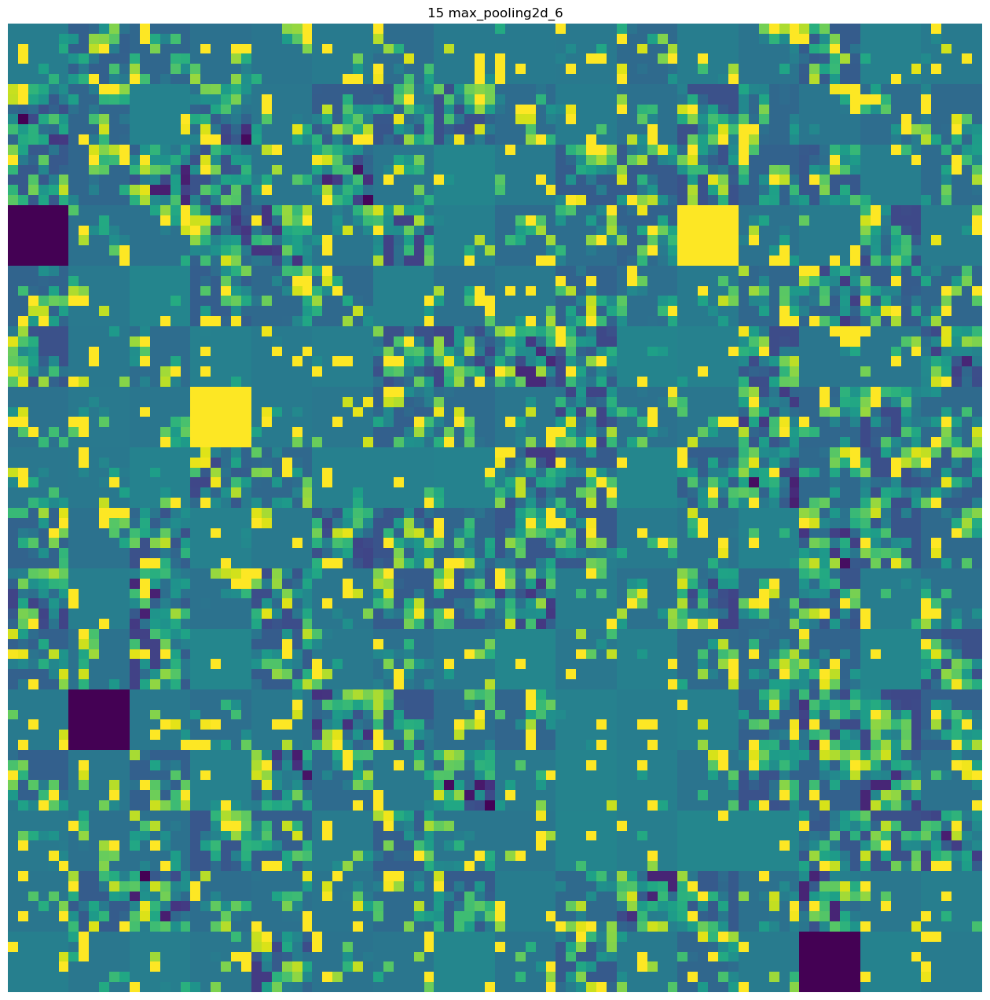

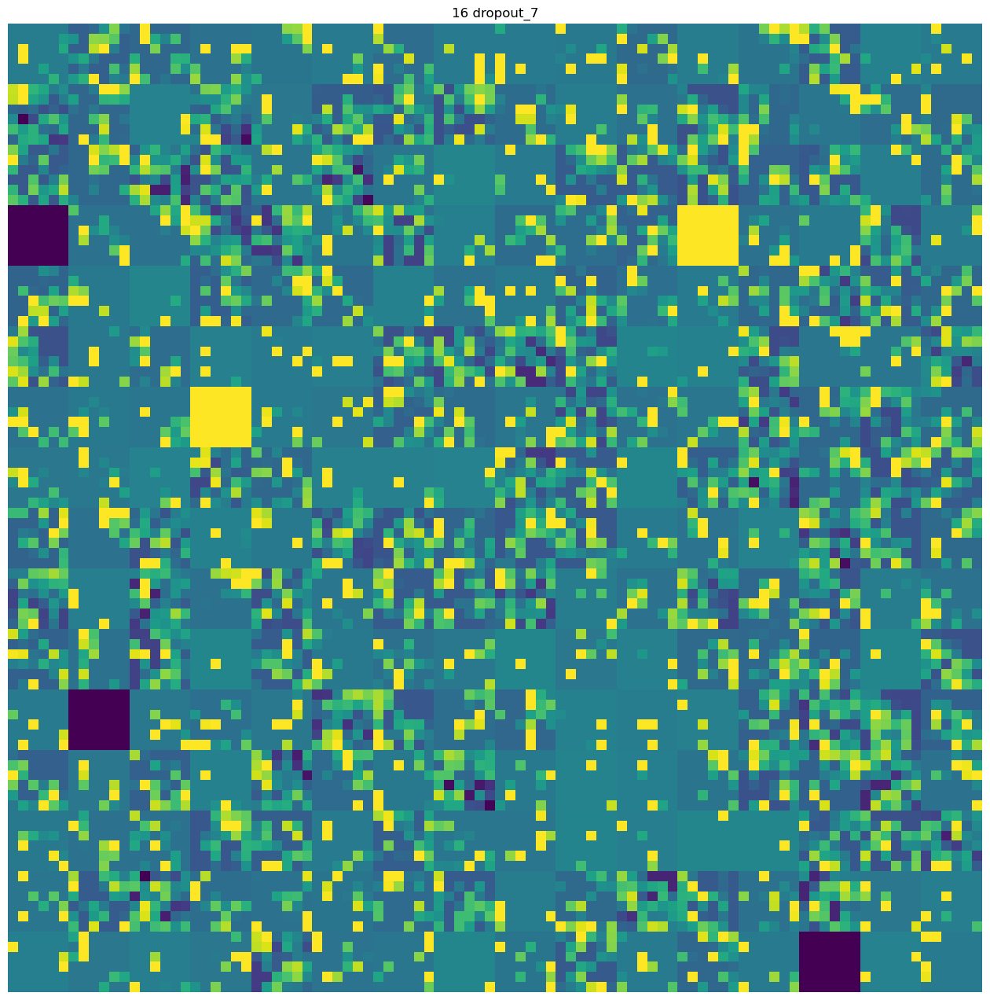

In [19]:
display_activations(img_pth = two_cats_img ,activations_model = activations_model
                    , images_per_row = 16 , save_dir = two_cats_activations)


<class 'numpy.ndarray'>
1/1 [==============================] - 0s 32ms/step
16
 layer n°0 shape : (1, 126, 126, 32)
 layer n°1 shape : (1, 126, 126, 32)
 layer n°2 shape : (1, 63, 63, 32)
 layer n°3 shape : (1, 63, 63, 32)
 layer n°4 shape : (1, 61, 61, 64)
 layer n°5 shape : (1, 61, 61, 64)
 layer n°6 shape : (1, 30, 30, 64)
 layer n°7 shape : (1, 30, 30, 64)
 layer n°8 shape : (1, 28, 28, 128)
 layer n°9 shape : (1, 28, 28, 128)
 layer n°10 shape : (1, 14, 14, 128)
 layer n°11 shape : (1, 14, 14, 128)
 layer n°12 shape : (1, 12, 12, 256)
 layer n°13 shape : (1, 12, 12, 256)
 layer n°14 shape : (1, 6, 6, 256)
 layer n°15 shape : (1, 6, 6, 256)
0 conv2d_3
1 batch_normalization_4
2 max_pooling2d_3
3 dropout_4
4 conv2d_4
5 batch_normalization_5
6 max_pooling2d_4
7 dropout_5
8 conv2d_5
9 batch_normalization_6
10 max_pooling2d_5
11 dropout_6
12 conv2d_6
13 batch_normalization_7
14 max_pooling2d_6
15 dropout_7
16 flatten_1
16
********************************************************
['01 con

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: divide by zero encountered in true_divide


(252, 2016)
(126, 1008)
(126, 1008)
(244, 976)
(244, 976)
(120, 480)
(120, 480)
(224, 448)
(224, 448)
(112, 224)
(112, 224)
(192, 192)
(192, 192)
(96, 96)
(96, 96)


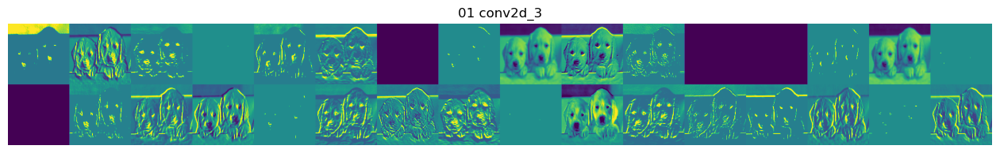

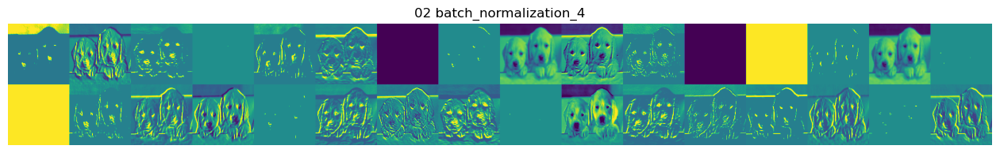

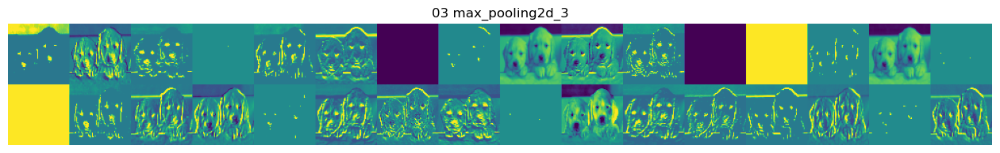

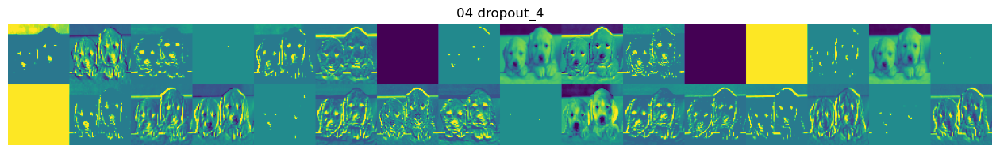

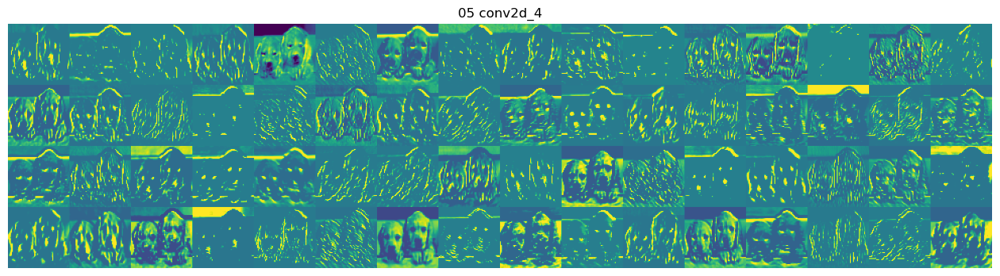

...

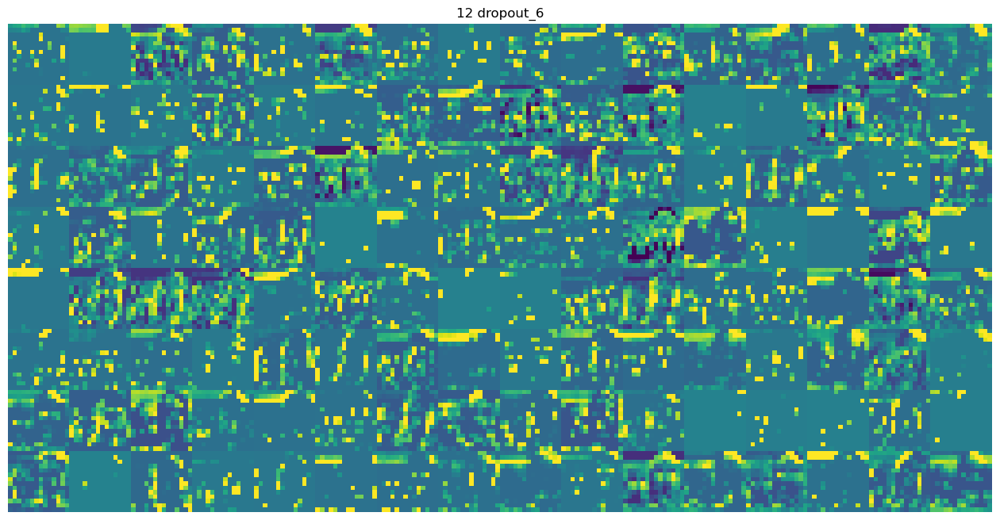

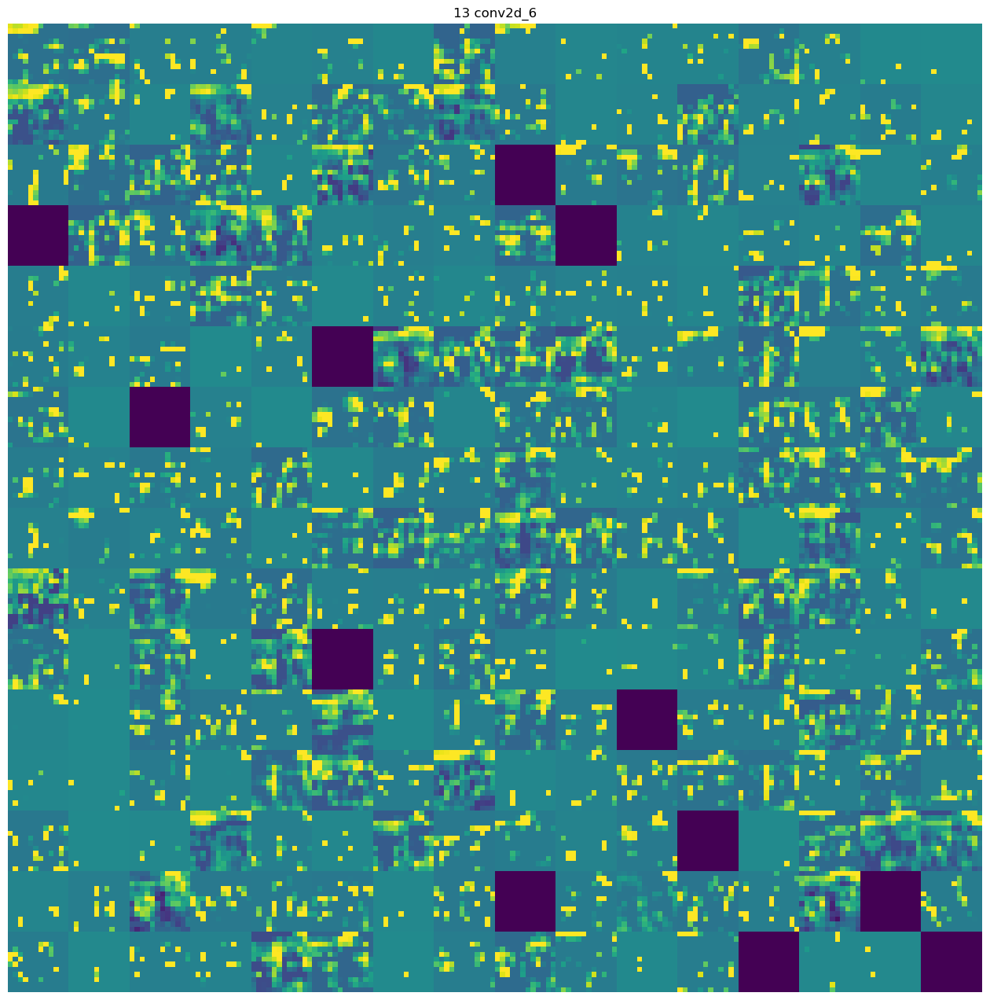

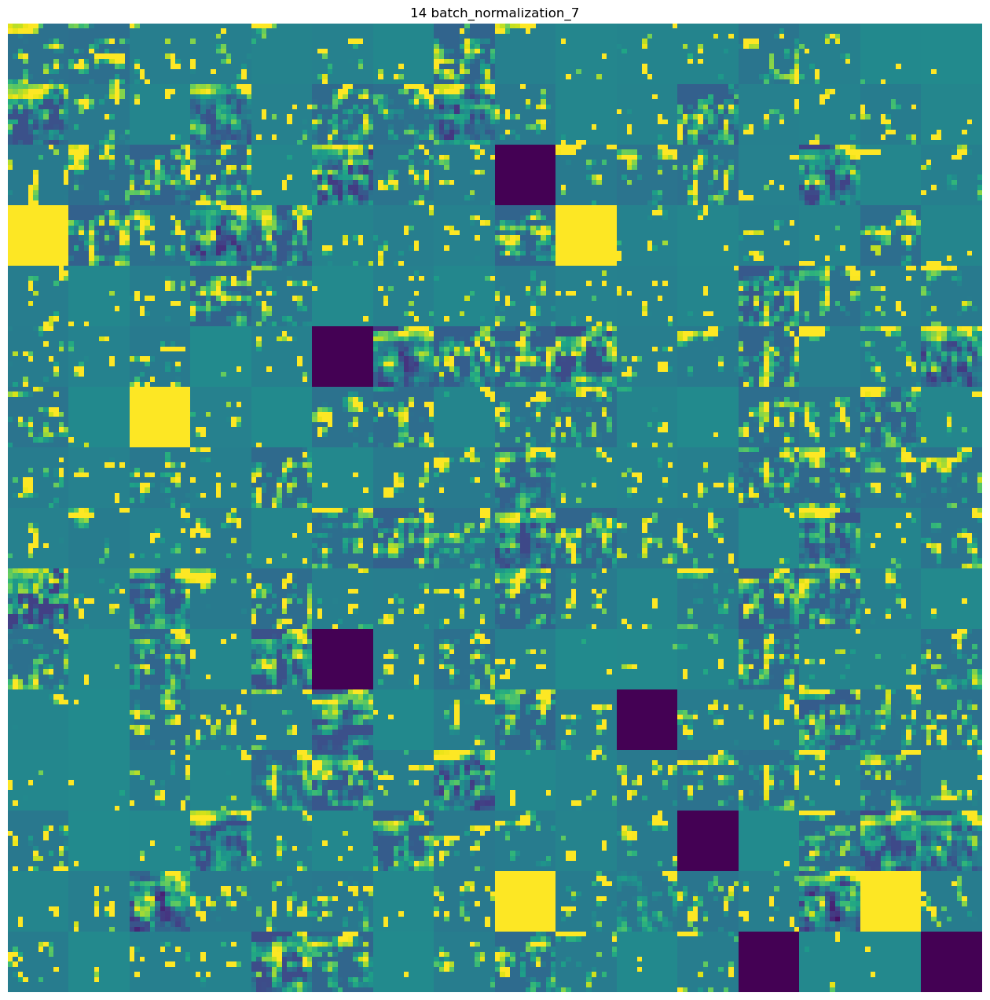

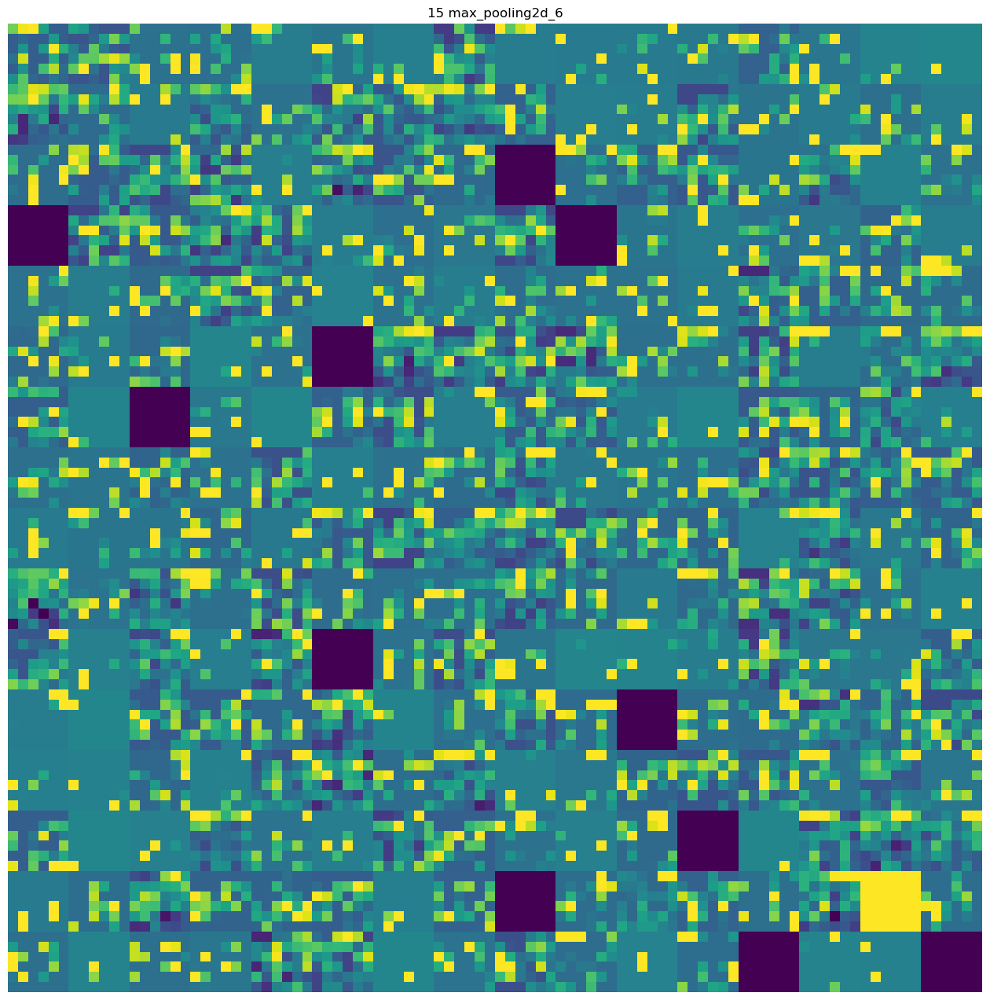

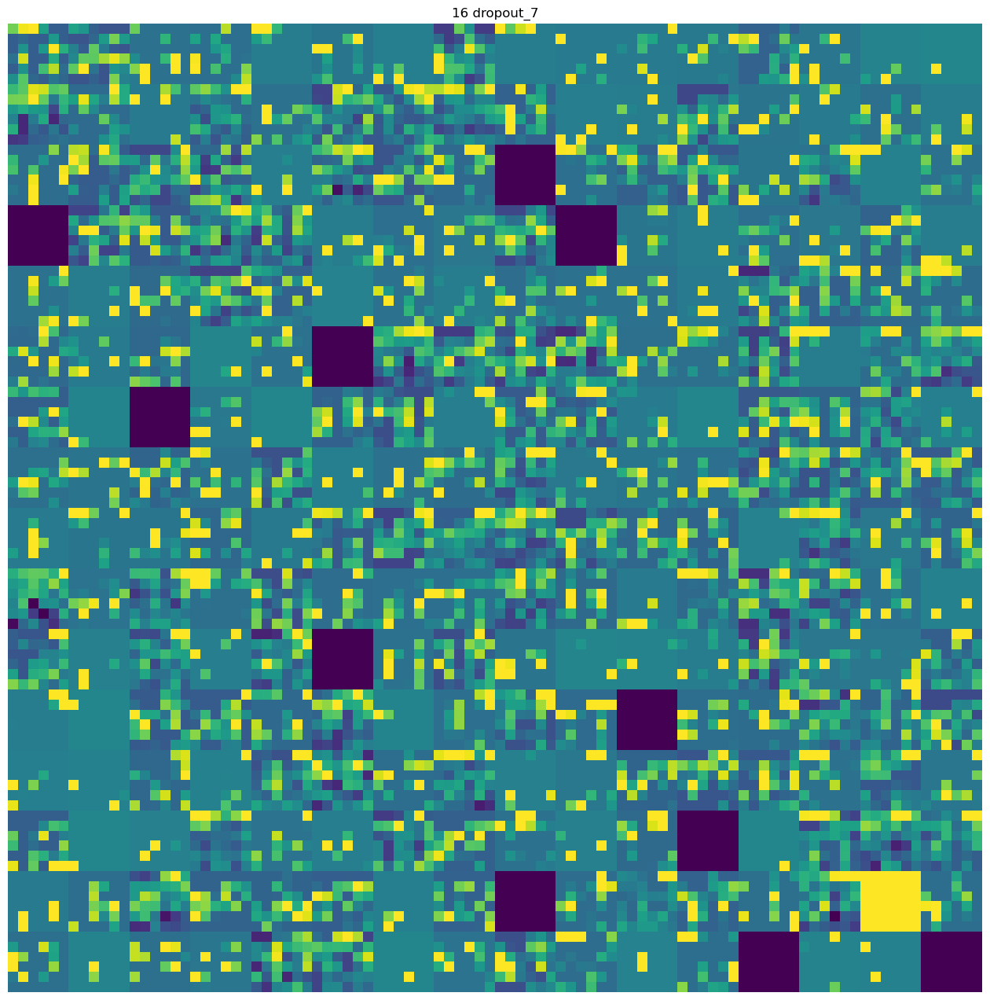

In [20]:
display_activations(img_pth = two_dogs_img ,activations_model = activations_model
                    , images_per_row = 16 , save_dir = two_dogs_activations)

In [21]:
center_imgs(dog_activations)
center_imgs(two_dogs_activations)
center_imgs(two_cats_activations)


15 max_pooling2d_6.png (1600, 1600, 3)
05 conv2d_4.png (1600, 1600, 3)
03 max_pooling2d_3.png (1600, 1600, 3)
16 dropout_7.png (1600, 1600, 3)
06 batch_normalization_5.png (1600, 1600, 3)
09 conv2d_5.png (1600, 1600, 3)
02 batch_normalization_4.png (1600, 1600, 3)
07 max_pooling2d_4.png (1600, 1600, 3)
01 conv2d_3.png (1600, 1600, 3)
04 dropout_4.png (1600, 1600, 3)
10 batch_normalization_6.png (1600, 1600, 3)
08 dropout_5.png (1600, 1600, 3)
11 max_pooling2d_5.png (1600, 1600, 3)
12 dropout_6.png (1600, 1600, 3)
14 batch_normalization_7.png (1600, 1600, 3)
13 conv2d_6.png (1600, 1600, 3)
15 max_pooling2d_6.png (1600, 1600, 3)
05 conv2d_4.png (1600, 1600, 3)
03 max_pooling2d_3.png (1600, 1600, 3)
16 dropout_7.png (1600, 1600, 3)
06 batch_normalization_5.png (1600, 1600, 3)
09 conv2d_5.png (1600, 1600, 3)
02 batch_normalization_4.png (1600, 1600, 3)
07 max_pooling2d_4.png (1600, 1600, 3)
01 conv2d_3.png (1600, 1600, 3)
04 dropout_4.png (1600, 1600, 3)
10 batch_normalization_6.png (1600,

In [22]:
create_gif(dog_activations,'dog activations.gif',fps = 0.5)
create_gif(two_cats_activations,'two cats activations.gif',fps = 0.5)
create_gif(two_dogs_activations,'two dogs activations.gif',fps = 0.5)

01 conv2d_3.png


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


02 batch_normalization_4.png
03 max_pooling2d_3.png
04 dropout_4.png
05 conv2d_4.png
06 batch_normalization_5.png
07 max_pooling2d_4.png
08 dropout_5.png
09 conv2d_5.png
10 batch_normalization_6.png
11 max_pooling2d_5.png
12 dropout_6.png
13 conv2d_6.png
14 batch_normalization_7.png
15 max_pooling2d_6.png
16 dropout_7.png
01 conv2d_3.png
02 batch_normalization_4.png
03 max_pooling2d_3.png
04 dropout_4.png
05 conv2d_4.png
06 batch_normalization_5.png
07 max_pooling2d_4.png
08 dropout_5.png
09 conv2d_5.png
10 batch_normalization_6.png
11 max_pooling2d_5.png
12 dropout_6.png
13 conv2d_6.png
14 batch_normalization_7.png
15 max_pooling2d_6.png
16 dropout_7.png
01 conv2d_3.png
02 batch_normalization_4.png
03 max_pooling2d_3.png
04 dropout_4.png
05 conv2d_4.png
06 batch_normalization_5.png
07 max_pooling2d_4.png
08 dropout_5.png
09 conv2d_5.png
10 batch_normalization_6.png
11 max_pooling2d_5.png
12 dropout_6.png
13 conv2d_6.png
14 batch_normalization_7.png
15 max_pooling2d_6.png
16 dropout_7.

In [35]:
shutil.rmtree('/kaggle/working/seri_acts')
os.makedirs('/kaggle/working/seri_acts')

In [13]:
def center_text(img,text='', font_scale = 0.5 ,offset = (0,0)):
    font = cv2.FONT_HERSHEY_SIMPLEX
    

    # Get the size of the text string
    (text_width, text_height) = cv2.getTextSize(text, font, font_scale, thickness=2)[0]

    # Calculate the x, y coordinates for the text
    x = int((img.shape[1] - text_width) / 2)
    y = text_height + 5

    img = cv2.putText(img,text,(x + offset[0],y + offset[1]),
                      font, font_scale, (0, 0, 255),
                      1, cv2.LINE_AA)



In [33]:
def get_single_activations(img_path, model ,save_dir ):
    # save the conv layers indices in a list
    conv_idxs = [i for i,layer in enumerate(model.layers) if "conv" in layer.name]
    print(conv_idxs)
    activations = get_model_activations(img_path,model)
    print(conv_idxs)
    for layer in conv_idxs:
        for feature_map in range(activations[layer].shape[3]):
            activation = activations[layer][0,:,:,feature_map]
            #print(np.max(activation))
            # Normalize the grayscale image
            normalized = cv2.normalize(activation, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
            #print(np.max(normalized))

            # Apply viridis colormap
            viridis = cv2.applyColorMap(normalized, cv2.COLORMAP_VIRIDIS)
            #print(viridis.shape)
            im_size = viridis.shape[0]
            viridis = cv2.resize(viridis,(256,256))

            #print(viridis.shape)


            border_width = 75
            border_color = [255, 255, 255]  # white color in BGR format

            # Add border to the image
            viridis = cv2.copyMakeBorder(viridis, border_width, border_width, 
                                         border_width, border_width, cv2.BORDER_CONSTANT, 
                                         value=border_color)

            # Get the size of the text string
            text1 = "Size -- Layer idx -- Feature map idx"
            text2=f'({im_size}x{im_size})--{layer:02d}--{feature_map:03d}'
            center_text(viridis,text1)
            center_text(viridis,text2,font_scale = 1 ,offset = (0,40))

            cv2.imwrite(f'{save_dir}/{layer:02d}--{feature_map:03d}.png',viridis)
    

In [36]:
get_single_activations(cat_img, activations_model , '/kaggle/working/seri_acts')

[0, 1, 5, 9, 13]
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 34ms/step
[0, 1, 5, 9, 13]


/kaggle/working/seri_acts/13--193.png
512


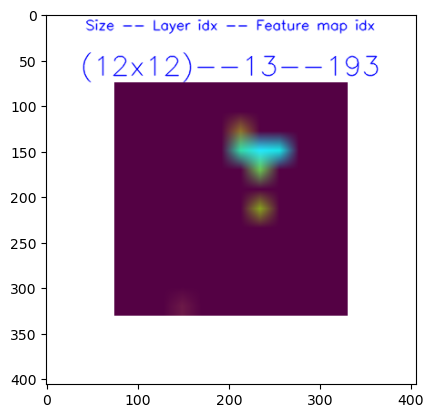

In [37]:
print(os.path.join('/kaggle/working/seri_acts', os.listdir('/kaggle/working/seri_acts')[5]))
plt.imshow(cv2.imread(os.path.join('/kaggle/working/seri_acts', os.listdir('/kaggle/working/seri_acts')[5])))
print(len(os.listdir('/kaggle/working/seri_acts')))   


In [39]:
create_gif('/kaggle/working/seri_acts','cat single activations.gif',fps = 5)

00--000.png
00--001.png
00--002.png
00--003.png
00--004.png
00--005.png


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


00--006.png
00--007.png
00--008.png
00--009.png
00--010.png
00--011.png
00--012.png
00--013.png
00--014.png
00--015.png
00--016.png
00--017.png
00--018.png
00--019.png
00--020.png
00--021.png
00--022.png
00--023.png
00--024.png
00--025.png
00--026.png
00--027.png
00--028.png
00--029.png
00--030.png
00--031.png
01--000.png
01--001.png
01--002.png
01--003.png
01--004.png
01--005.png
01--006.png
01--007.png
01--008.png
01--009.png
01--010.png
01--011.png
01--012.png
01--013.png
01--014.png
01--015.png
01--016.png
01--017.png
01--018.png
01--019.png
01--020.png
01--021.png
01--022.png
01--023.png
01--024.png
01--025.png
01--026.png
01--027.png
01--028.png
01--029.png
01--030.png
01--031.png
05--000.png
05--001.png
05--002.png
05--003.png
05--004.png
05--005.png
05--006.png
05--007.png
05--008.png
05--009.png
05--010.png
05--011.png
05--012.png
05--013.png
05--014.png
05--015.png
05--016.png
05--017.png
05--018.png
05--019.png
05--020.png
05--021.png
05--022.png
05--023.png
05--024.png
05--

<class 'numpy.ndarray'>
1/1 [==============================] - 0s 31ms/step
[0, 4, 8, 12]
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


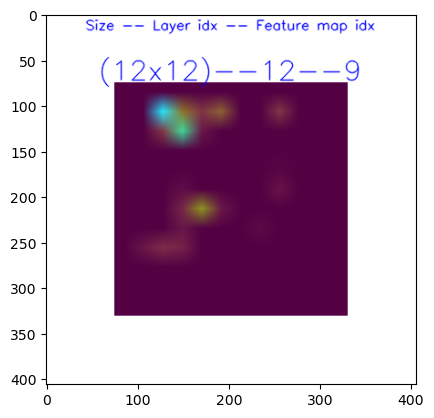

In [64]:
# save the conv layers indices in a list
conv_idxs = [i for i,layer in enumerate(model.layers) if "conv" in layer.name]
activations = get_model_activations(cat_img,activations_model)
print(conv_idxs)
for layer in conv_idxs:
    for feature_map in range(activations[layer].shape[3]):
        activation = activations[layer][0,:,:,feature_map]
        #print(np.max(activation))
        # Normalize the grayscale image
        normalized = cv2.normalize(activation, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        #print(np.max(normalized))

        # Apply viridis colormap
        viridis = cv2.applyColorMap(normalized, cv2.COLORMAP_VIRIDIS)
        #print(viridis.shape)
        im_size = viridis.shape[0]
        viridis = cv2.resize(viridis,(256,256))
        
        print(viridis.shape)
        

        border_width = 75
        border_color = [255, 255, 255]  # white color in BGR format

        # Add border to the image
        viridis = cv2.copyMakeBorder(viridis, border_width, border_width, 
                                     border_width, border_width, cv2.BORDER_CONSTANT, 
                                     value=border_color)

        # Get the size of the text string
        text1 = "Size -- Layer idx -- Feature map idx"
        text2=f'({im_size}x{im_size})--{layer}--{feature_map}'
        center_text(viridis,text1)
        center_text(viridis,text2,font_scale = 1 ,offset = (0,45))
       
        cv2.imwrite(f'/kaggle/working/seri_acts/{layer}--{feature_map}.png',viridis)

print(os.path.join('/kaggle/working/seri_acts', os.listdir('/kaggle/working/seri_acts')[5]))
plt.imshow(cv2.imread(os.path.join('/kaggle/working/seri_acts', os.listdir('/kaggle/working/seri_acts')[5])))
        
        

In [63]:
def horizontal_activations(img_path, model):
    activations = get_model_activations(img_path,model)
    for i in range(len(activations.shape[3]))
    activations[0][0,:,:,4]
    
    

SyntaxError: invalid syntax (2882388545.py, line 3)

In [61]:
!zip -r file.zip /kaggle/working/seri_acts


/bin/bash: /opt/conda/lib/libtinfo.so.6: no version information available (required by /bin/bash)
updating: kaggle/working/seri_acts/ (stored 0%)
updating: kaggle/working/seri_acts/12--167.png (deflated 23%)
updating: kaggle/working/seri_acts/8--85.png (deflated 17%)
updating: kaggle/working/seri_acts/12--178.png (deflated 26%)
updating: kaggle/working/seri_acts/12--80.png (deflated 25%)
updating: kaggle/working/seri_acts/12--189.png (deflated 22%)
updating: kaggle/working/seri_acts/12--9.png (deflated 25%)
updating: kaggle/working/seri_acts/12--99.png (deflated 36%)
updating: kaggle/working/seri_acts/12--154.png (deflated 35%)
updating: kaggle/working/seri_acts/12--230.png (deflated 27%)
updating: kaggle/working/seri_acts/12--109.png (deflated 26%)
updating: kaggle/working/seri_acts/8--84.png (deflated 18%)
updating: kaggle/working/seri_acts/8--32.png (deflated 17%)
updating: kaggle/working/seri_acts/12--91.png (deflated 32%)
updating: kaggle/working/seri_acts/4--50.png (deflated 6%)


In [27]:
print(len(os.listdir('/kaggle/working/seri_acts')))

480
